## setup

In [18]:
%matplotlib inline

In [19]:
from matplotlib import pyplot as plt
from gluoncv.utils import download, viz, bbox
import numpy as np
import json
import boto3
import cv2
import os


In [20]:
rekognition = boto3.client('rekognition')
s3 = boto3.client('s3')

In [116]:
project_arn = 'arn:aws:rekognition:us-east-1:496010403454:project/team-logos/1588082715775'
model_arn = 'arn:aws:rekognition:us-east-1:496010403454:project/team-logos/version/team-logos.2020-05-12T13.28.30/1589304510222'
#model_arn = 'arn:aws:rekognition:us-east-1:496010403454:project/station-logos/version/station-logos.2020-05-11T17.47.40/1589233660786'
model_name = model_arn.split('/')[-2]
model_name

'team-logos.2020-05-12T13.28.30'

In [117]:
TMP_DIR = './tmp'
!mkdir $TMP_DIR

mkdir: ./tmp: File exists


In [118]:
!python ../src/logo_detect/app/model_control.py start_model $project_arn $model_arn 1 

Starting model: arn:aws:rekognition:us-east-1:496010403454:project/team-logos/version/team-logos.2020-05-12T13.28.30/1589304510222
An error occurred (ResourceInUseException) when calling the StartProjectVersion operation: ProjectVersion arn:aws:rekognition:us-east-1:496010403454:project/team-logos/version/team-logos.2020-05-12T13.28.30/1589304510222 is RUNNING; cannot be started
Done...


In [119]:
!aws rekognition describe-project-versions --project-arn $project_arn --version-names $model_name --query 'ProjectVersionDescriptions[0].Status'

"RUNNING"


## Test single image

In [202]:
s3_bucket = 'video-processing-dev-496010403454-us-east-1'
s3_key = 'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:23:333000.jpg'
# s3_key = 'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:16:333000.jpg'
s3_key = 'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:18:333000.jpg'
s3_key = 'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:21:333000.jpg'

# s3_key = 'frames/demo-pipeline/demo_1280_720/original/2020/05/11/13/59:11:333000.jpg'

min_confidence = 0

In [210]:
TEAM_CLASSES = ['atlanta',
    'dallas',
    'kansas-city',
    'miami',
    'mls',
    'montreal',
    'northwestern',
    'nyc',
    'orlando',
    'phily',
    'portland',
    'san-jose']
STATION_CLASSES = [
    "amazon_elemental",
    "big_10",
    "channel_c",
    "channel_d",
    "channel_e",
    "cns-network",
    "cns-station-character",
    "cnstv"]
CLASSES = TEAM_CLASSES
CLASSES_MAP = { c: i for i, c in enumerate(CLASSES) }
CLASSES_MAP

{'atlanta': 0,
 'dallas': 1,
 'kansas-city': 2,
 'miami': 3,
 'mls': 4,
 'montreal': 5,
 'northwestern': 6,
 'nyc': 7,
 'orlando': 8,
 'phily': 9,
 'portland': 10,
 'san-jose': 11}

In [204]:
def read_img_from_s3(s3_key, s3_bucket, working_dir):
    filename = os.path.basename(s3_key)
    filepath = os.path.join(working_dir, filename)
    s3.download_file(s3_bucket, s3_key, filepath)
    img = cv2.cvtColor(cv2.imread(filepath), cv2.COLOR_BGR2RGB)
    return img

def infer_from_custom_labels(s3_bucket, s3_key):
    img_data = {'S3Object': {'Bucket': s3_bucket, 'Name': s3_key}}
    response = rekognition.detect_custom_labels(
        Image=img_data, MinConfidence=min_confidence, ProjectVersionArn=model_arn
    )
    return response


In [205]:
img = read_img_from_s3(s3_key, s3_bucket, TMP_DIR)
rek_response = infer_from_custom_labels(s3_bucket, s3_key)

In [206]:
rek_response

{'CustomLabels': [{'Name': 'atlanta',
   'Confidence': 26.41200065612793,
   'Geometry': {'BoundingBox': {'Width': 0.029729999601840973,
     'Height': 0.025830000638961792,
     'Left': 0.8116300106048584,
     'Top': 0.6869000196456909}}},
  {'Name': 'portland',
   'Confidence': 25.615001678466797,
   'Geometry': {'BoundingBox': {'Width': 0.0412600003182888,
     'Height': 0.0532200001180172,
     'Left': 0.6787099838256836,
     'Top': 0.6213899850845337}}},
  {'Name': 'dallas',
   'Confidence': 22.797000885009766,
   'Geometry': {'BoundingBox': {'Width': 0.034370001405477524,
     'Height': 0.05243000015616417,
     'Left': 0.2995400130748749,
     'Top': 0.420960009098053}}},
  {'Name': 'portland',
   'Confidence': 22.588998794555664,
   'Geometry': {'BoundingBox': {'Width': 0.019349999725818634,
     'Height': 0.02450999990105629,
     'Left': 0.7124699950218201,
     'Top': 0.6241199970245361}}},
  {'Name': 'portland',
   'Confidence': 21.477001190185547,
   'Geometry': {'Boundi

In [207]:
rek_xywh = np.array([
    [bbox_rek['Geometry']['BoundingBox']['Left'] * img.shape[1], 
     bbox_rek['Geometry']['BoundingBox']['Top']* img.shape[0],
     bbox_rek['Geometry']['BoundingBox']['Width']* img.shape[1],
     bbox_rek['Geometry']['BoundingBox']['Height'] * img.shape[0]] 
    for bbox_rek in rek_response['CustomLabels']])

In [208]:
rek_xyxy = bbox.bbox_xywh_to_xyxy(rek_xywh) if rek_xywh.size > 0 else np.array([])
scores = np.array([label['Confidence'] for label in rek_response['CustomLabels'] ])
labels = np.array([CLASSES_MAP[label['Name']]for label in rek_response['CustomLabels']  ])
class_names = CLASSES

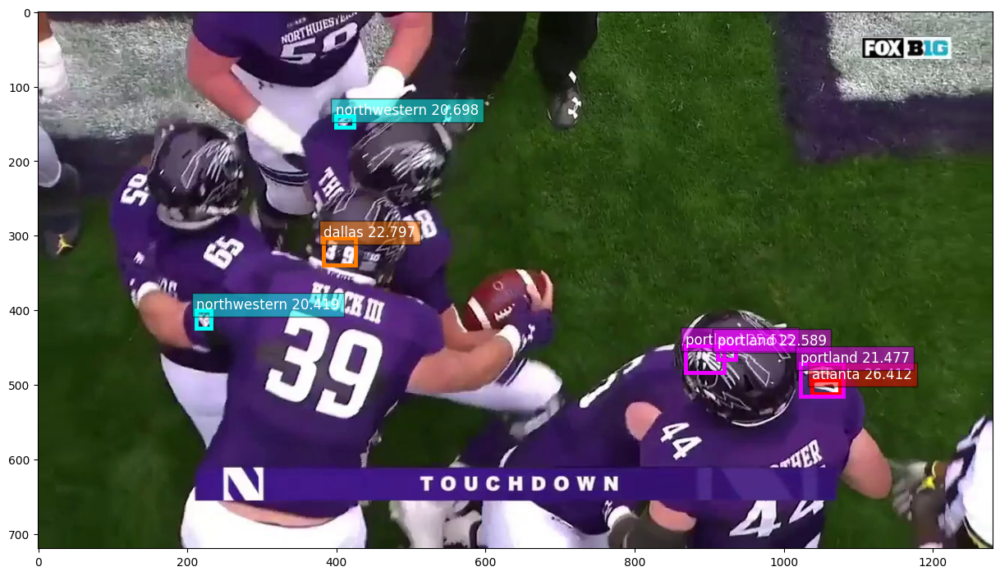

In [209]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15, 10), facecolor='white', dpi=100)
axis=axes

ax = viz.plot_bbox(img, rek_xyxy, scores=scores, labels=labels, class_names=class_names, ax=axis)

# Inference in batches

In [189]:
s3_keys = []

imgs = []
bboxes = []
scores = []
labels = []


## option 1: list s3 keys by prefix

In [ ]:

bucket =  boto3.resource('s3').Bucket(s3_bucket)
s3_prefix = 'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/'

object_iterator = bucket.objects.filter(
    MaxKeys=123,
    Prefix=s3_prefix
)

for o in object_iterator:
    if o.key.endswith('jpg') and 'crop' not in o.key:
        s3_keys.append(o.key)


## option 2: list s3 keys explictly

In [212]:
s3_keys = [
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/13/59:11:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:21:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:22:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:23:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:24:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:25:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:26:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:27:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:28:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:32:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:33:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:26:333000.jpg',
    'frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:58:333000.jpg'
]


In [213]:
len(s3_keys)

13

In [192]:
for s3_key in s3_keys:
    img = read_img_from_s3(s3_key, s3_bucket, TMP_DIR)
    imgs.append(img)
    rek_response = infer_from_custom_labels(s3_bucket, s3_key)
    rek_xywh = np.array([
    [bbox_rek['Geometry']['BoundingBox']['Left'] * img.shape[1], 
     bbox_rek['Geometry']['BoundingBox']['Top']* img.shape[0],
     bbox_rek['Geometry']['BoundingBox']['Width']* img.shape[1],
     bbox_rek['Geometry']['BoundingBox']['Height'] * img.shape[0]] 
    for bbox_rek in rek_response['CustomLabels']])
    rek_xyxy = bbox.bbox_xywh_to_xyxy(rek_xywh) if rek_xywh.size > 0 else np.array([])
    bboxes.append(rek_xyxy)
    scores.append(np.array([label['Confidence'] for label in rek_response['CustomLabels'] ]))
    labels.append(np.array([CLASSES_MAP[label['Name']]for label in rek_response['CustomLabels']  ]))
    print(f'inference completed for s3://{s3_bucket}/{s3_key}')

inference completed for s3://video-processing-dev-496010403454-us-east-1/frames/demo-pipeline/demo_1280_720/original/2020/05/11/13/59:11:333000.jpg
inference completed for s3://video-processing-dev-496010403454-us-east-1/frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:21:333000.jpg
inference completed for s3://video-processing-dev-496010403454-us-east-1/frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:22:333000.jpg
inference completed for s3://video-processing-dev-496010403454-us-east-1/frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:23:333000.jpg
inference completed for s3://video-processing-dev-496010403454-us-east-1/frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:24:333000.jpg
inference completed for s3://video-processing-dev-496010403454-us-east-1/frames/demo-pipeline/demo_1280_720/original/2020/05/11/14/01:25:333000.jpg
inference completed for s3://video-processing-dev-496010403454-us-east-1/frames/demo-pipeline/demo_1280_720/orig

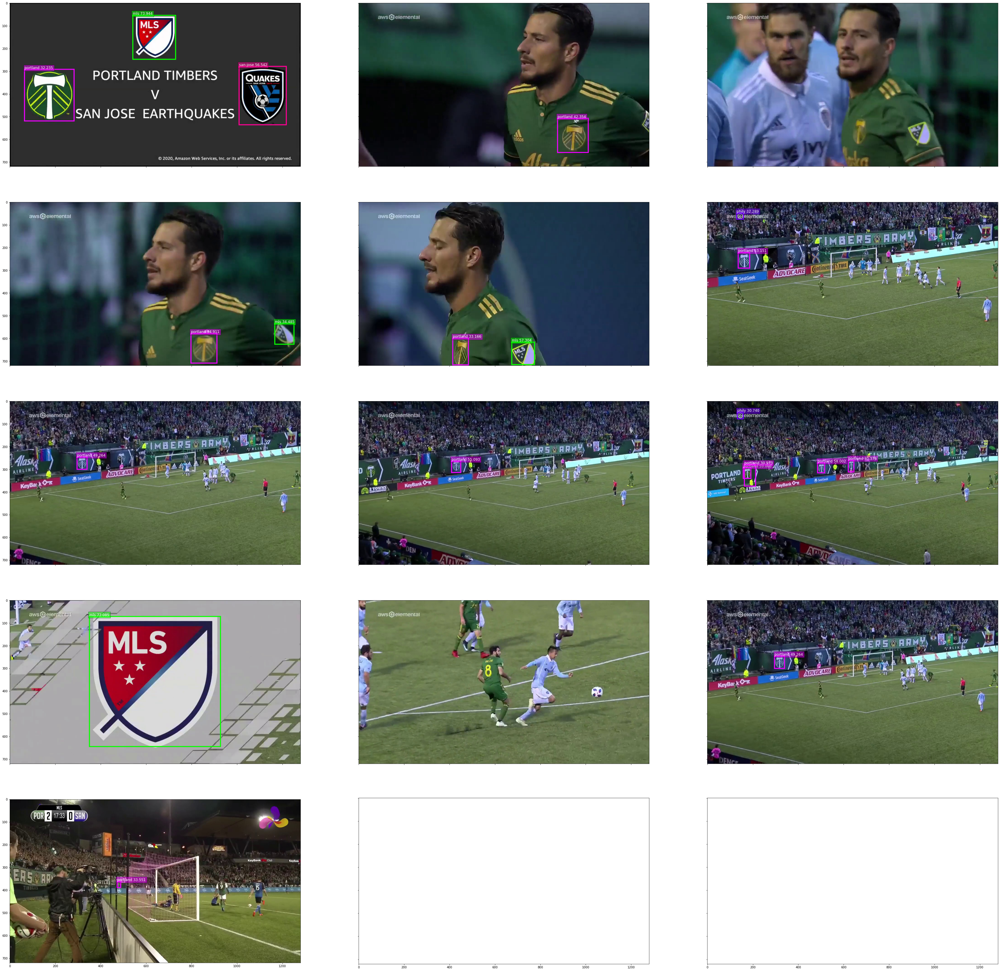

In [193]:
import matplotlib.pyplot as plt
import math
limit = 30
i = 0

nrows, ncols = math.ceil(min(len(labels), limit)/3), 3
_, axs = plt.subplots(nrows, ncols, sharex=True, sharey=True, figsize=(60, 60))

for ax, img, bb, score, label in zip(axs.ravel(), imgs, bboxes,scores,labels):
    ax = viz.plot_bbox(img, bb, scores=score, labels=label, class_names=CLASSES, ax=ax)
    ax.grid(False)
    i +=1 
    if i > limit:
        break
plt.show()

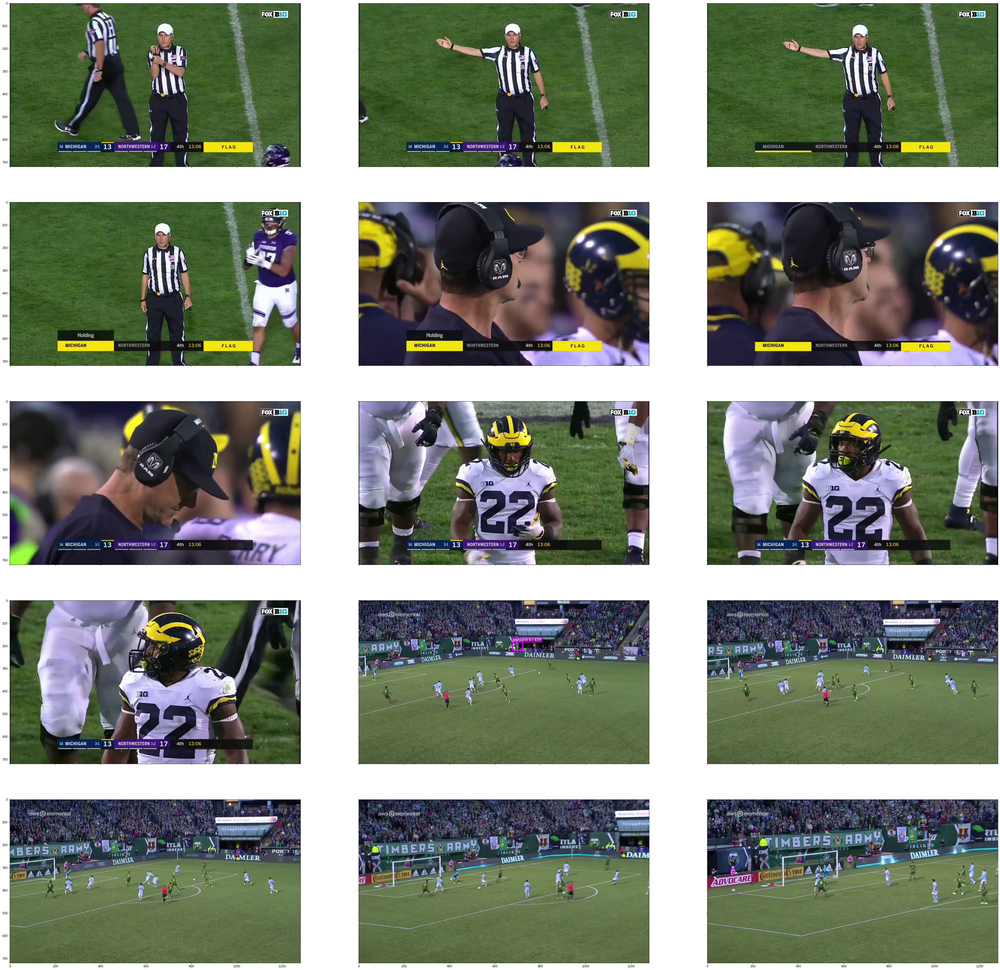

In [141]:
imgs = imgs[limit:]
bboxes = bboxes[limit:]
scores = scores[limit:]
labels = labels[limit:]

limit = 15
i = 0

nrows, ncols = math.ceil(min(len(labels), limit)/3), 3
_, axs = plt.subplots(nrows, ncols, sharex=True, sharey=True, figsize=(60, 60))

for ax, img, bb, score, label in zip(axs.ravel(), imgs, bboxes,scores,labels):
    ax = viz.plot_bbox(img, bb, scores=score, labels=label, class_names=CLASSES, ax=ax)
    ax.grid(False)
    i +=1 
    if i > limit:
        break
plt.show()

In [94]:
!python ../src/logo_detect/app/model_control.py stop_model  $model_arn 

Stopping model:arn:aws:rekognition:us-east-1:496010403454:project/team-logos/version/team-logos.2020-05-12T00.31.58/1589257918719
Status: STOPPING
Done...
